# Januar Study

## Imports

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import numpy as np
from glob import glob
from pathlib import Path
import matplotlib.pyplot as plt
import pandas as pd 
import seaborn as sns
import matplotlib
from math import pow, sqrt, ceil, cos, sin, pi
from collections import OrderedDict

from sklearn.metrics import accuracy_score, cohen_kappa_score, confusion_matrix
from sklearn.neighbors import KDTree

In [3]:
from PIL import Image as PILImage
import matplotlib.patches as patches

In [4]:
from Analysis.annotations import Annotation
from Analysis.image import Image
from Analysis.expert import Expert, DatasetType, ProjectType
from Analysis.statistics import Statistics

In [5]:
from utils import *

In [6]:
#plt.rcParams["font.family"] = "Times New Roman"
plt.rcParams["font.size"] = 25

In [7]:
def point_on_circle(center, radius, angle):
    '''
        Finding the x,y coordinates on circle, based on given angle
    '''
    #center of circle, angle in degree and radius of circle
    x = center[0] + (radius * cos(angle))
    y = center[1] + (radius * sin(angle))

    return x,y

In [8]:
symbols = {}
offset = {}

for id, symbol, angle in zip([3,4,5,6,7,8,9,11,12,13], 
                        ["o", "D", '*', "<", "X", "^", ">","v", "P", "p"], 
                             np.linspace(0, 360, num = 10)):
    symbols["Expert_{}".format(id)] = symbol
    offset["Expert_{}".format(id)] = point_on_circle((0,0), 1, angle)
offset

{'Expert_3': (1.0, 0.0),
 'Expert_4': (-0.6669380616522619, 0.7451131604793488),
 'Expert_5': (-0.11038724383904756, -0.9938886539233752),
 'Expert_6': (0.8141809705265618, 0.5806111842123143),
 'Expert_7': (-0.9756293127952373, 0.21942525837900473),
 'Expert_8': (0.4871876750070059, -0.8732972972139946),
 'Expert_9': (0.32578130553514806, 0.9454451549211168),
 'Expert_11': (-0.9217395798793158, -0.3878094208292295),
 'Expert_12': (0.903705111970614, -0.42815542808445156),
 'Expert_13': (-0.2836910914865273, 0.9589157234143065)}

## LabelBox EIPH Results

### Annotations:

In [9]:
#Name	Dataset	ProjectType	Nr. Annotations	Seconds

seconds = [139,118,93,103,76,194,79,48,66,120]
num_annotations = [254,232,218,224,219,204,231,175,211,242]
mious = [0.56,0.49,0.59,0.43,0.34,0.49,0.68,0.34,0.49,0.49]

label_box_data = []
for second, num_anno, miou in zip(seconds, num_annotations, mious):
    label_box_data.append(["LabelBox", DatasetType.EIPH_LabelBox, ProjectType.Annotation, num_anno, second, miou])
     
label_box_data.append(["GT", DatasetType.EIPH_LabelBox, ProjectType.GroundTruth, 282, 0, 0])

### Algorithm:

In [10]:
#Name	Dataset	ProjectType	Nr. Annotations	Seconds

seconds = [113,79,24,67,119,11,53,60,138,117]
num_annotations = [238,241,238,236,235,231,229,233,237,232]
mious = [0.58,0.58,0.59,0.5,0.46,0.57,0.54,0.59,0.66,0.57]

for second, num_anno, miou in zip(seconds, num_annotations, mious):
    label_box_data.append(["LabelBox", DatasetType.EIPH_LabelBox, ProjectType.ExpertAlgorithm, num_anno, second, miou])
     
labelbox_results = pd.DataFrame(label_box_data, columns=['Name', 'Dataset', 'ProjectType', 'Nr. Annotations', 'Seconds', 'mIoU'])
labelbox_results.head()

,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
0,LabelBox,EIPH_LabelBox,Annotation,254,139,0.56
1,LabelBox,EIPH_LabelBox,Annotation,232,118,0.49
2,LabelBox,EIPH_LabelBox,Annotation,218,93,0.59
3,LabelBox,EIPH_LabelBox,Annotation,224,103,0.43
4,LabelBox,EIPH_LabelBox,Annotation,219,76,0.34


## Load Annotations 

In [11]:
path = Path("Results/*/*")
files = glob(str(path)+"/Participants/*.txt")

users_first_round = []

for file_name in files:
    participant = "Expert_" + Path(file_name).stem.split("_")[-1]
    dataset_type = DatasetType.Asthma
    project_type = ProjectType.Annotation if "FirstRound" in file_name else ProjectType.ExpertAlgorithm
    
    if "EIPH" in file_name:
        dataset_type = DatasetType.EIPH_Exact
    elif "Mitosen" in file_name:
        dataset_type = DatasetType.MitoticFigure
    
    
    expert = Expert(participant, BBType.Detected, dataset_type, project_type)
    expert.add_file(file_name)

    users_first_round.append(expert)

In [12]:
files_gt = glob(str(path)+"/GT/ground truth.txt")

gt_results = []
for file_name in files_gt:
    
    participant = Path(file_name).stem.split("_")[-1]
    dataset_type = DatasetType.Asthma
    project_type = ProjectType.GroundTruth
    
    if "EIPH" in file_name:
        dataset_type = DatasetType.EIPH_Exact
    elif "Mitosen" in file_name:
        dataset_type = DatasetType.MitoticFigure
        
    gt = Expert(participant, BBType.GroundTruth, dataset_type, project_type)
    gt.add_file(file_name)

    gt_results.append(gt)
    
gt_results

[ground truth:  Annos: 458 Seconds: 0.0 Type: Asthma Project: GroundTruth,
 ground truth:  Annos: 458 Seconds: 0.0 Type: Asthma Project: GroundTruth,
 ground truth:  Annos: 237 Seconds: 0.0 Type: EIPH_Exact Project: GroundTruth,
 ground truth:  Annos: 237 Seconds: 0.0 Type: EIPH_Exact Project: GroundTruth,
 ground truth:  Annos: 712 Seconds: 0.0 Type: MitoticFigure Project: GroundTruth]

In [13]:
statistics = Statistics(users_first_round + gt_results)

In [14]:
global_statistics = statistics.calc_statistics()
global_statistics = pd.concat([global_statistics, labelbox_results])
global_statistics

,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
0,Expert_11,Asthma,Annotation,408,114.500000,0.765555
1,Expert_12,Asthma,Annotation,410,164.761905,0.742201
2,Expert_13,Asthma,Annotation,402,113.380952,0.775339
3,Expert_3,Asthma,Annotation,397,56.200000,0.564124
4,Expert_4,Asthma,Annotation,413,140.250000,0.777429
5,Expert_5,Asthma,Annotation,406,96.600000,0.822691
6,Expert_6,Asthma,Annotation,402,72.800000,0.783585
7,Expert_7,Asthma,Annotation,409,95.800000,0.593223
8,Expert_8,Asthma,Annotation,410,85.150000,0.749041
9,Expert_9,Asthma,Annotation,406,126.500000,0.767858


## Statistics EIPH

In [15]:
eiph_statistics = global_statistics[global_statistics['Dataset'] == DatasetType.EIPH_Exact]

### ProjectType.Annotation

In [16]:
eiph_Annotation = eiph_statistics[eiph_statistics['ProjectType'] == ProjectType.Annotation]

for column in ['Seconds', 'mIoU']:
    df = eiph_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
eiph_Annotation

Seconds: Min: 29.75 Max: 99.55  Mean: 51.17  STD: 20.55
mIoU: Min: 0.39 Max: 0.60  Mean: 0.47  STD: 0.06


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
14,Expert_11,EIPH_Exact,Annotation,220,57.25,0.472632
15,Expert_12,EIPH_Exact,Annotation,232,68.55,0.478452
16,Expert_13,EIPH_Exact,Annotation,180,55.90,0.458652
17,Expert_3,EIPH_Exact,Annotation,213,29.75,0.401095
18,Expert_4,EIPH_Exact,Annotation,236,99.55,0.598128
19,Expert_5,EIPH_Exact,Annotation,190,36.00,0.514733
20,Expert_6,EIPH_Exact,Annotation,199,43.75,0.533542
21,Expert_7,EIPH_Exact,Annotation,212,34.25,0.427200
22,Expert_8,EIPH_Exact,Annotation,197,29.80,0.387971
23,Expert_9,EIPH_Exact,Annotation,182,56.90,0.448380


### ProjectType.ExpertAlgorithm

In [17]:
eiph_Annotation = eiph_statistics[eiph_statistics['ProjectType'] == ProjectType.ExpertAlgorithm]

for column in ['Seconds', 'mIoU']:
    df = eiph_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
eiph_Annotation

Seconds: Min: 27.30 Max: 76.00  Mean: 45.71  STD: 19.20
mIoU: Min: 0.53 Max: 0.67  Mean: 0.59  STD: 0.05


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
24,Expert_11,EIPH_Exact,ExpertAlgorithm,234,31.20,0.667428
25,Expert_5,EIPH_Exact,ExpertAlgorithm,189,48.35,0.588693
26,Expert_6,EIPH_Exact,ExpertAlgorithm,230,76.00,0.581329
27,Expert_8,EIPH_Exact,ExpertAlgorithm,231,27.30,0.530669


## Statistics Asthma

In [18]:
asthma_statistics = global_statistics[global_statistics['Dataset'] == DatasetType.Asthma]

### ProjectType.Annotation

In [19]:
asthma_Annotation = asthma_statistics[asthma_statistics['ProjectType'] == ProjectType.Annotation]

for column in ['Seconds', 'mIoU']:
    df = asthma_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
    
asthma_Annotation

Seconds: Min: 56.20 Max: 164.76  Mean: 106.59  STD: 30.62
mIoU: Min: 0.56 Max: 0.82  Mean: 0.73  STD: 0.08


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
0,Expert_11,Asthma,Annotation,408,114.500000,0.765555
1,Expert_12,Asthma,Annotation,410,164.761905,0.742201
2,Expert_13,Asthma,Annotation,402,113.380952,0.775339
3,Expert_3,Asthma,Annotation,397,56.200000,0.564124
4,Expert_4,Asthma,Annotation,413,140.250000,0.777429
5,Expert_5,Asthma,Annotation,406,96.600000,0.822691
6,Expert_6,Asthma,Annotation,402,72.800000,0.783585
7,Expert_7,Asthma,Annotation,409,95.800000,0.593223
8,Expert_8,Asthma,Annotation,410,85.150000,0.749041
9,Expert_9,Asthma,Annotation,406,126.500000,0.767858


### ProjectType.ExpertAlgorithm

In [20]:
asthma_Annotation = asthma_statistics[asthma_statistics['ProjectType'] == ProjectType.ExpertAlgorithm]

for column in ['Seconds', 'mIoU']:
    df = asthma_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
asthma_Annotation

Seconds: Min: 12.50 Max: 20.80  Mean: 17.34  STD: 3.01
mIoU: Min: 0.83 Max: 0.86  Mean: 0.84  STD: 0.01


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
10,Expert_11,Asthma,ExpertAlgorithm,410,17.95,0.838042
11,Expert_5,Asthma,ExpertAlgorithm,404,18.10,0.856270
12,Expert_6,Asthma,ExpertAlgorithm,408,12.50,0.847912
13,Expert_8,Asthma,ExpertAlgorithm,414,20.80,0.831152


## Statistics Mitotic Figure

In [21]:
mitosis_statistics = global_statistics[global_statistics['Dataset'] == DatasetType.MitoticFigure]

### ProjectType.Annotation

In [22]:
mitosis_Annotation = mitosis_statistics[mitosis_statistics['ProjectType'] == ProjectType.Annotation]

for column in ['Seconds', 'mIoU']:
    df = mitosis_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
mitosis_Annotation

Seconds: Min: 137.50 Max: 590.75  Mean: 338.23  STD: 144.67
mIoU: Min: 0.31 Max: 0.54  Mean: 0.43  STD: 0.07


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
28,Expert_11,MitoticFigure,Annotation,637,242.05,0.482243
29,Expert_12,MitoticFigure,Annotation,334,478.55,0.307468
30,Expert_13,MitoticFigure,Annotation,351,206.00,0.400343
31,Expert_3,MitoticFigure,Annotation,654,137.50,0.535215
32,Expert_4,MitoticFigure,Annotation,694,590.75,0.371878
33,Expert_5,MitoticFigure,Annotation,884,420.65,0.472055
34,Expert_6,MitoticFigure,Annotation,673,363.45,0.396619
35,Expert_7,MitoticFigure,Annotation,482,233.30,0.386967
36,Expert_8,MitoticFigure,Annotation,725,213.95,0.519079
37,Expert_9,MitoticFigure,Annotation,628,496.10,0.440741


### ProjectType.ExpertAlgorithm

In [23]:
mitosis_Annotation = mitosis_statistics[mitosis_statistics['ProjectType'] == ProjectType.ExpertAlgorithm]

for column in ['Seconds', 'mIoU']:
    df = mitosis_Annotation[column]
    print(column + ": Min: {0:.2f} Max: {1:.2f}  Mean: {2:.2f}  STD: {3:.2f}".format(np.min(df), np.max(df), np.mean(df), np.std(df)))
mitosis_Annotation

Seconds: Min: 61.70 Max: 248.95  Mean: 157.01  STD: 66.28
mIoU: Min: 0.71 Max: 0.77  Mean: 0.74  STD: 0.03


,Name,Dataset,ProjectType,Nr. Annotations,Seconds,mIoU
38,Expert_11,MitoticFigure,ExpertAlgorithm,728,162.70,0.752914
39,Expert_5,MitoticFigure,ExpertAlgorithm,811,154.70,0.774949
40,Expert_6,MitoticFigure,ExpertAlgorithm,849,248.95,0.721745
41,Expert_8,MitoticFigure,ExpertAlgorithm,760,61.70,0.710512


## Statistics

### Total Annotations 

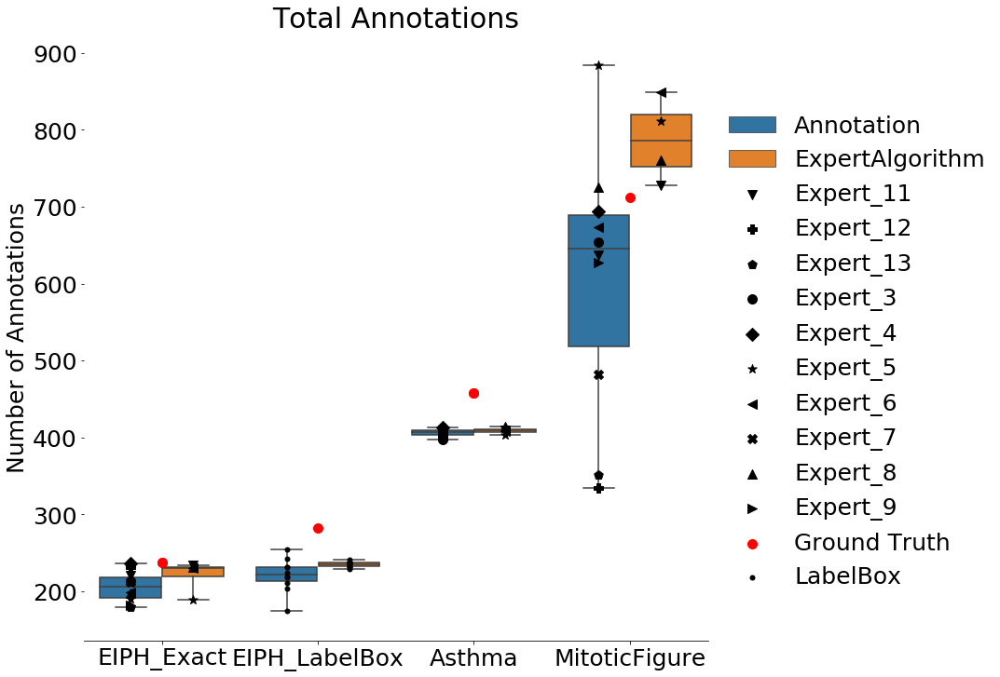

In [24]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="Dataset", y="Nr. Annotations", data= temp, showfliers=False, hue='ProjectType', whis=np.inf,
                 order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure],
                 hue_order=[ProjectType.Annotation, ProjectType.ExpertAlgorithm])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[3]
    
    type_offset = -0.2
    if project_type == ProjectType.ExpertAlgorithm:
        type_offset = 0.2
    
    x = 0
    if dataset == DatasetType.EIPH_LabelBox:
        x = 1
    elif dataset == DatasetType.Asthma:
        x = 2
    elif dataset == DatasetType.MitoticFigure:
        x = 3
        
    if project_type != ProjectType.GroundTruth:
        plt.scatter(x=x + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  
    else:    
        plt.scatter(x=x, y=value, s=100, zorder=110, c='red', label="Ground Truth")  
    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Number of Annotations", xlabel="", title="Total Annotations")
sns.despine(left=True)

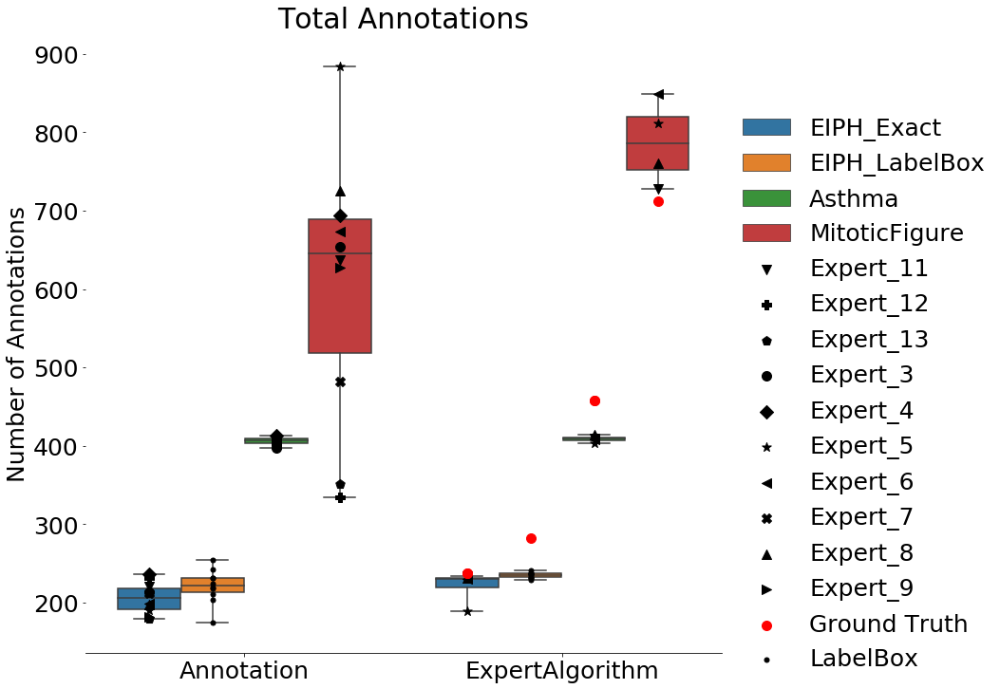

In [25]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="ProjectType", y="Nr. Annotations", data= temp, showfliers=False, hue='Dataset', whis=np.inf,
                 hue_order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[3]
    
    type_offset = -0.3
    if dataset == DatasetType.EIPH_LabelBox:
        type_offset = -0.1
    elif dataset == DatasetType.Asthma:
        type_offset = 0.1
    elif dataset == DatasetType.MitoticFigure:
        type_offset = 0.3

    if project_type == ProjectType.Annotation:
        plt.scatter(x=0 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  
    elif project_type == ProjectType.ExpertAlgorithm:
        plt.scatter(x=1 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".") 
    else: # GT
#         plt.scatter(x=0 + type_offset, y=value, s=100, zorder=110, c='red', label="GT")
        plt.scatter(x=1 + type_offset, y=value, s=100, zorder=110, c='red', label="Ground Truth")  
    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Number of Annotations", xlabel="", title="Total Annotations")
sns.despine(left=True)

### Seconds per Image

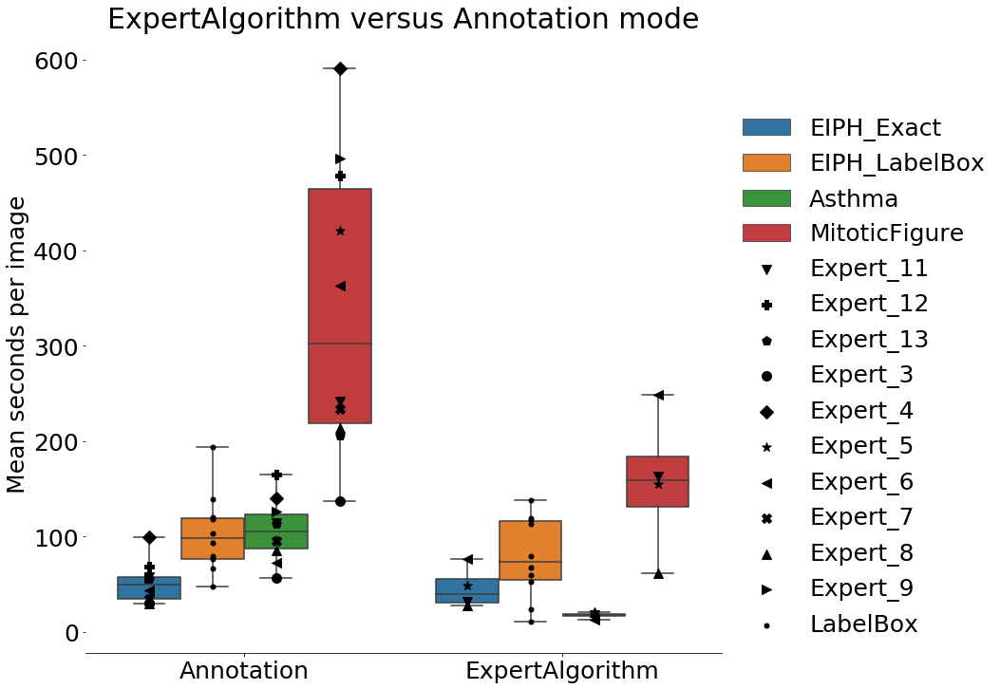

In [26]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="ProjectType", y="Seconds", data= temp, showfliers=False, hue='Dataset', whis=np.inf, 
                 hue_order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[4]
    
    type_offset = -0.3
    if dataset == DatasetType.EIPH_LabelBox:
        type_offset = -0.1
    elif dataset == DatasetType.Asthma:
        type_offset = 0.1
    elif dataset == DatasetType.MitoticFigure:
        type_offset = 0.3

    if project_type == ProjectType.Annotation:
        plt.scatter(x=0 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  
    elif project_type == ProjectType.ExpertAlgorithm:
        plt.scatter(x=1 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".") 

    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Mean seconds per image", xlabel="", title="ExpertAlgorithm versus Annotation mode")
sns.despine(left=True)

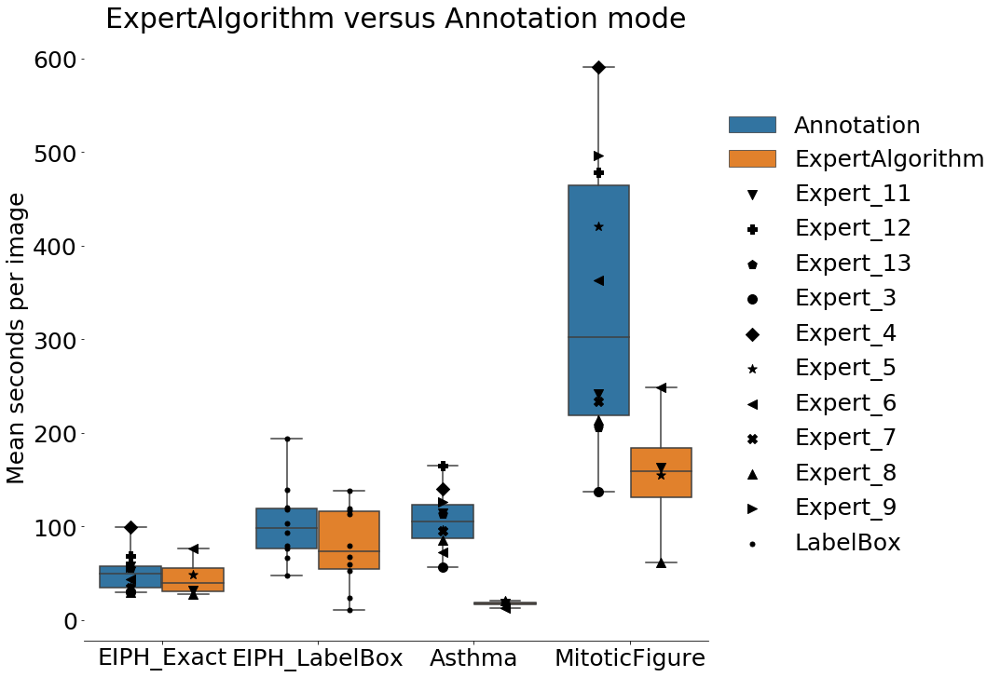

In [27]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="Dataset", y="Seconds", data= temp, showfliers=False, hue='ProjectType', whis=np.inf,
                 order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure],
                 hue_order=[ProjectType.Annotation, ProjectType.ExpertAlgorithm])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[4]
    
    type_offset = -0.2
    if project_type == ProjectType.ExpertAlgorithm:
        type_offset = 0.2
    
    x = 0
    if dataset == DatasetType.EIPH_LabelBox:
        x = 1
    elif dataset == DatasetType.Asthma:
        x = 2
    elif dataset == DatasetType.MitoticFigure:
        x = 3
        
    if project_type != ProjectType.GroundTruth:
        plt.scatter(x=x + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  

    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Mean seconds per image", xlabel="", title="ExpertAlgorithm versus Annotation mode")
sns.despine(left=True)

### Mean intersection over union

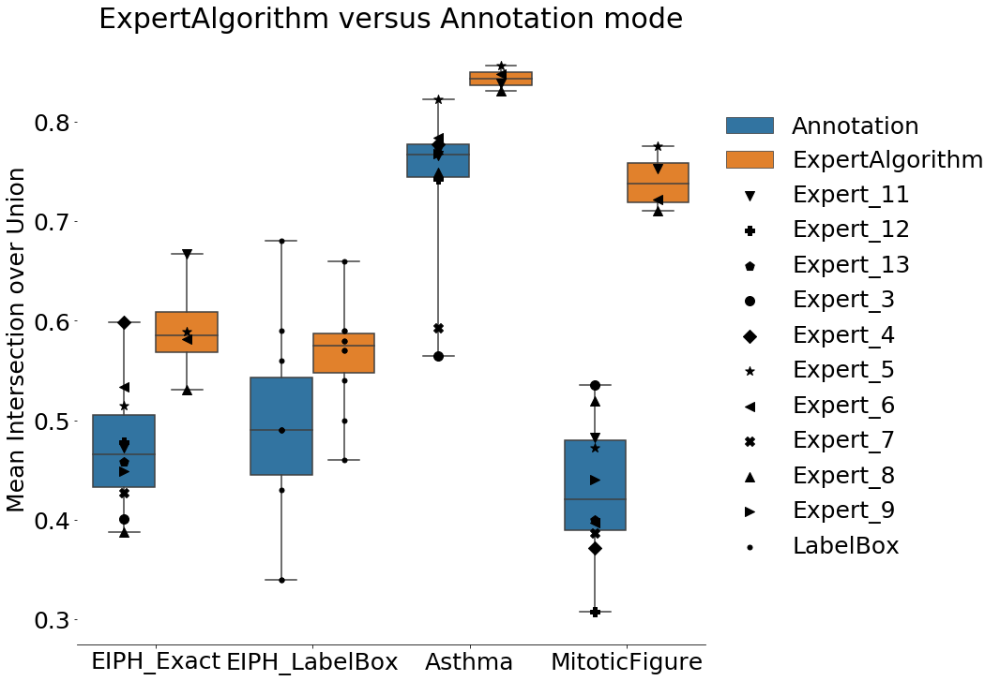

In [28]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="Dataset", y="mIoU", data= temp, showfliers=False, hue='ProjectType', whis=np.inf, 
                 order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure],
                 hue_order=[ProjectType.Annotation, ProjectType.ExpertAlgorithm])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[5]
    
    type_offset = -0.2
    if project_type == ProjectType.ExpertAlgorithm:
        type_offset = 0.2
    
    x = 0
    if dataset == DatasetType.EIPH_LabelBox:
        x = 1
    elif dataset == DatasetType.Asthma:
        x = 2
    elif dataset == DatasetType.MitoticFigure:
        x = 3
        
    if project_type != ProjectType.GroundTruth:
        plt.scatter(x=x + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  

    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Mean Intersection over Union", xlabel="", title="ExpertAlgorithm versus Annotation mode")
sns.despine(left=True)

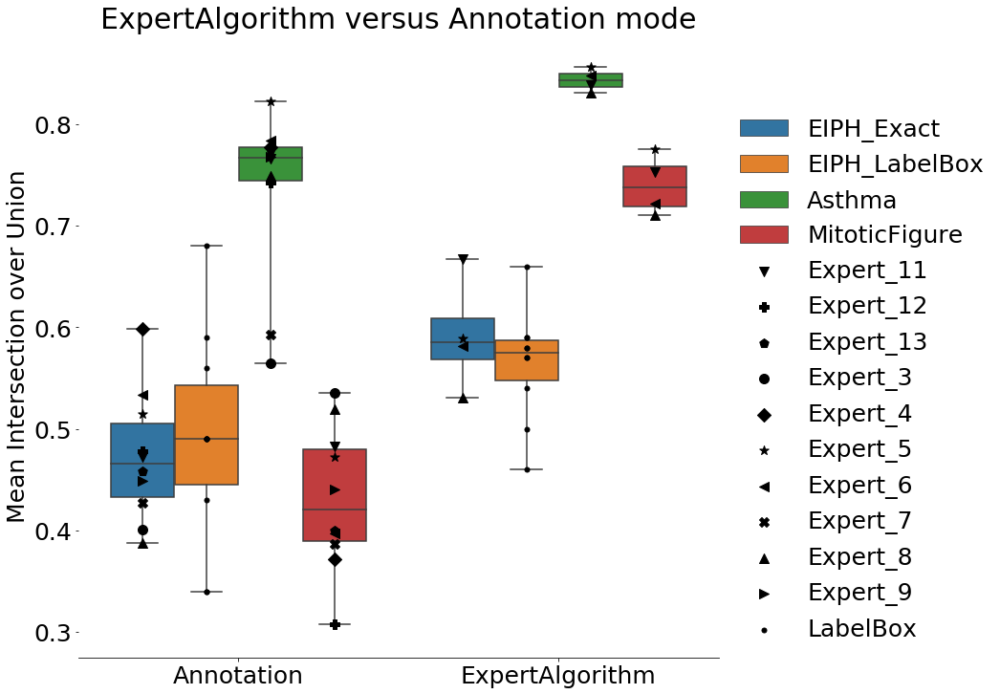

In [29]:
f, ax = plt.subplots(figsize=(12, 12))

temp = global_statistics[global_statistics["ProjectType"] != ProjectType.GroundTruth]
ax = sns.boxplot(x="ProjectType", y="mIoU", data= temp, showfliers=False, hue='Dataset', whis=np.inf, 
                 hue_order=[DatasetType.EIPH_Exact, DatasetType.EIPH_LabelBox, DatasetType.Asthma, DatasetType.MitoticFigure])

for index, row in enumerate(global_statistics.values.tolist()):
    name  = row[0]
    dataset = row[1]
    project_type = row[2]
    value = row[5]
    
    type_offset = -0.3
    if dataset == DatasetType.EIPH_LabelBox:
        type_offset = -0.1
    elif dataset == DatasetType.Asthma:
        type_offset = 0.1
    elif dataset == DatasetType.MitoticFigure:
        type_offset = 0.3

    if project_type == ProjectType.Annotation:
        plt.scatter(x=0 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".")  
    elif project_type == ProjectType.ExpertAlgorithm:
        plt.scatter(x=1 + type_offset, y=value, s=100, zorder=100, c='black', label=name, marker=symbols[name] if name in symbols else ".") 
    
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1., 0.9), frameon=False)

ax.set(ylabel="Mean Intersection over Union", xlabel="", title="ExpertAlgorithm versus Annotation mode")
sns.despine(left=True)

## Show Images

In [30]:
folder = Path('D:\\ProgProjekte\\Python\\Exact\\Converter\\result')
image_paths = glob(str(folder) + "\\astma\\*.png") + glob(str(folder) + "\\eiph\\*.png") + glob(str(folder) + "\\mitosen\\*.tiff")

image_paths = [Path(path) for path in image_paths]

path_dict = {path.name:path for path in image_paths}

In [31]:
file_name = '2e611073cff18d503cea.tiff'

annotations = statistics.get_annotations(file_name)
annotations.head()

,Name,Vector,Label,ProjectType
0,Expert_11,"[3199, 4073, 3249, 4123]",mitotic figure,Annotation
1,Expert_11,"[281, 1775, 331, 1825]",mitotic figure,Annotation
2,Expert_13,"[275, 1776, 325, 1826]",mitotic figure,Annotation
3,Expert_3,"[1604, 789, 1654, 839]",mitotic figure,Annotation
4,Expert_4,"[279, 1797, 329, 1847]",mitotic figure,Annotation


In [32]:
center_anno, center_count, patch_borders = statistics.get_most_active_region(file_name)
x_min, y_min, x_max, y_max = patch_borders

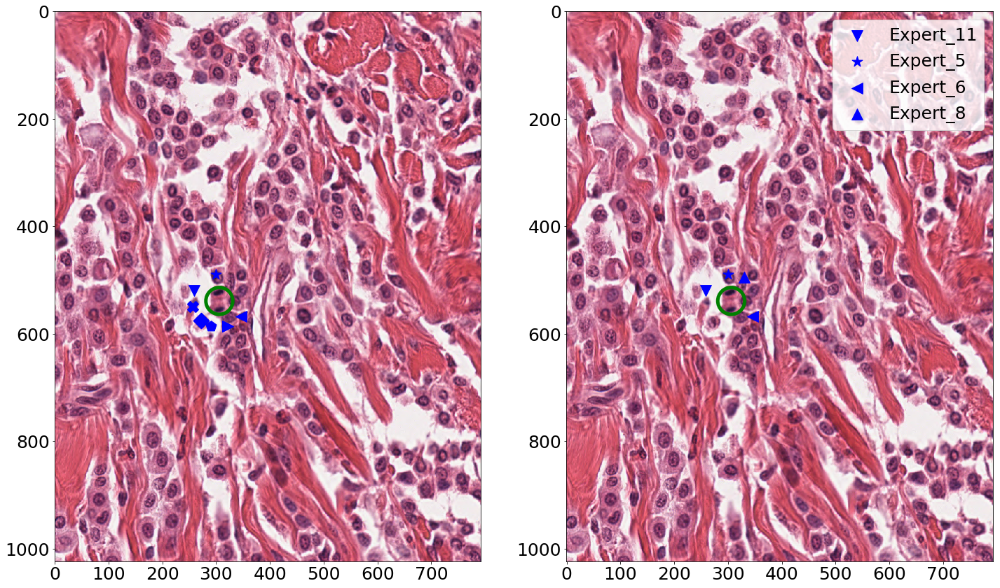

In [33]:
im = np.array(PILImage.open(str(path_dict[file_name])), dtype=np.uint8)[y_min:y_max, x_min:x_max]

fig = plt.figure(figsize=(24, 24))

#fig, ax = plt.subplots(figsize=(12, 12))
ax_anno = fig.add_subplot(1,2, 1)
ax_alg = fig.add_subplot(1,2, 2)

ax_anno.imshow(im)
ax_alg.imshow(im)

# draw ground truth 
drawn_centers = []

gt_annotations = annotations[annotations['ProjectType'] == ProjectType.GroundTruth]
for name, vector, label, project_type in gt_annotations.values.tolist():
    if vector[0] < x_min or vector[1] < y_min or  vector[2] > x_max or vector[3] > y_max:
        continue           
    
    if project_type == ProjectType.GroundTruth:
        #circle = patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none')
        
        ax_anno.add_patch(patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none'))   
        ax_alg.add_patch(patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none'))   
        
        center = (vector[0] + (vector[2] - vector[0]) / 2, vector[1] + (vector[3] - vector[1]) / 2)
        drawn_centers.append(center)
            


participants_annos = annotations[annotations['ProjectType'] != ProjectType.GroundTruth]
for name, vector, label, project_type in participants_annos.values.tolist():
    
    if vector[0] < x_min or vector[1] < y_min or  vector[2] > x_max or vector[3] > y_max:
        continue
    
    tree = KDTree(drawn_centers) 
    
    center = (vector[0] + (vector[2] - vector[0]) / 2, vector[1] + (vector[3] - vector[1]) / 2)
    index_per_point = tree.query_radius([center], r=25)[0]
    
    circle_center = (vector[0] - x_min + 25, vector[1] - y_min + 25)
    if len(index_per_point) == 0:
        circle = patches.Circle(circle_center, 25, linewidth=5, edgecolor='r', facecolor='none')
        
        if project_type == ProjectType.Annotation:
            ax_anno.add_patch(circle)  
        else:
            ax_alg.add_patch(circle)  
        
        drawn_centers.append(center)
    else:
        circle_center = drawn_centers[index_per_point[0]]
        circle_center = (circle_center[0] - x_min, circle_center[1] - y_min)
        
        
    #  draw symbol around circle
    x = int(circle_center[0] + 50 * offset[name][0])
    y = int(circle_center[1] + 50 * offset[name][1])
    
    if project_type == ProjectType.Annotation:
        ax_anno.scatter(x= x, y= y, marker=symbols[name], label=name, s=250, c='b', zorder=100)
    else:
        ax_alg.scatter(x= x, y= y, marker=symbols[name], label=name, s=250, c='b', zorder=100)
        
        
handles, labels = plt.gca().get_legend_handles_labels()
by_label = OrderedDict(zip(labels, handles))
ax_alg.legend(by_label.values(), by_label.keys(), frameon=True)
      
plt.show()

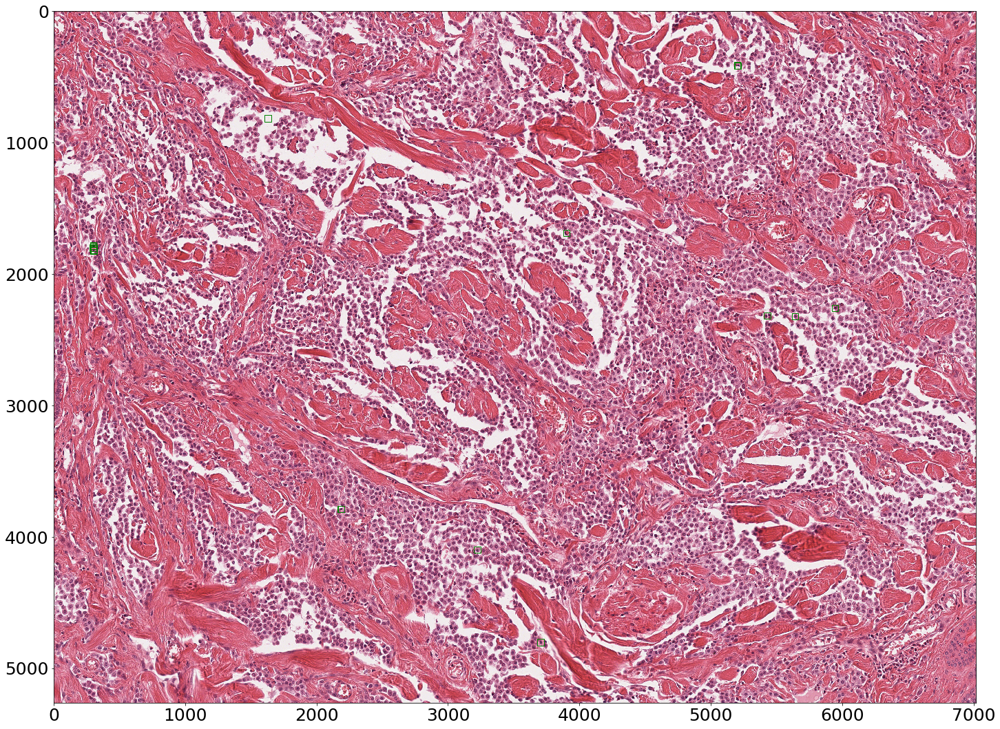

In [34]:
im = np.array(PILImage.open(str(path_dict[file_name])), dtype=np.uint8)


fig, ax = plt.subplots(figsize=(24, 24))

ax.imshow(im)

for name, vector, label, _ in annotations.values.tolist():

    rect = patches.Rectangle((vector[0], vector[1]), vector[2] - vector[0], vector[3] - vector[1], linewidth=1, edgecolor='g', facecolor='none')
    ax.add_patch(rect)     
      
plt.show()

066c94c4c161224077a9.tiff


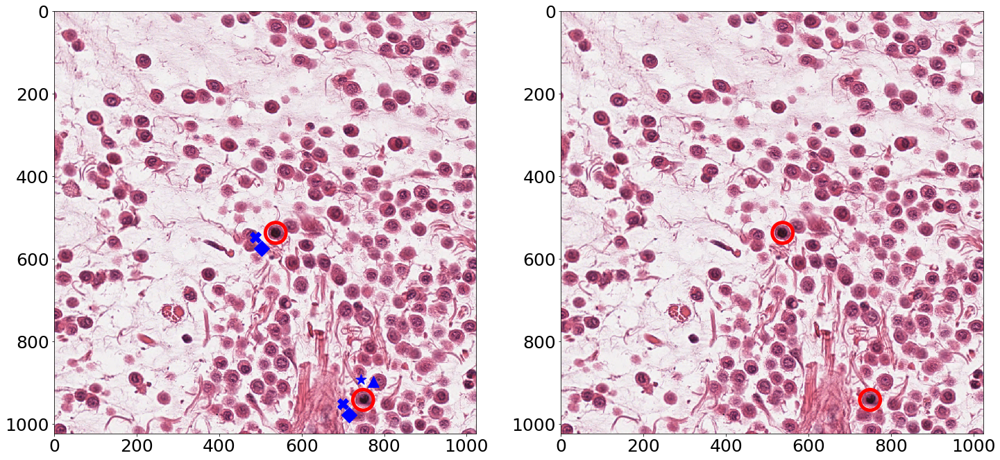

0e56fd11a762be0983f0.tiff


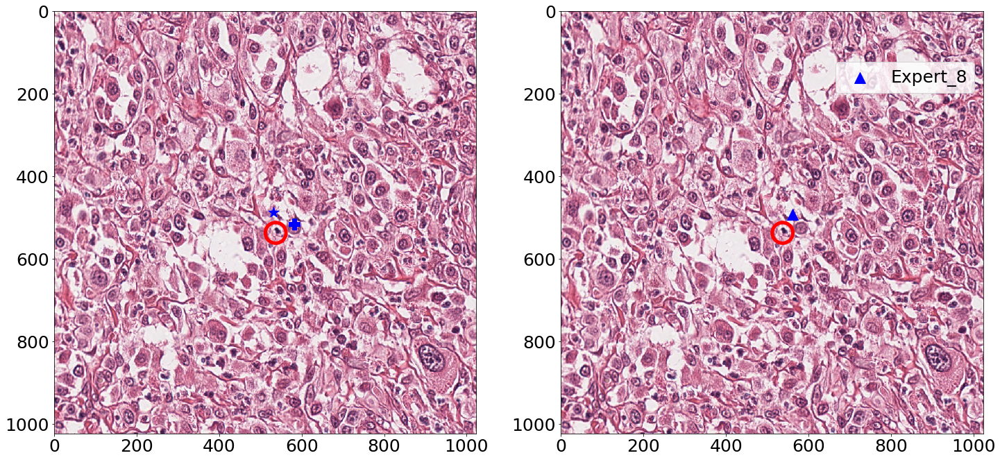

20c0753af38303691b27.tiff


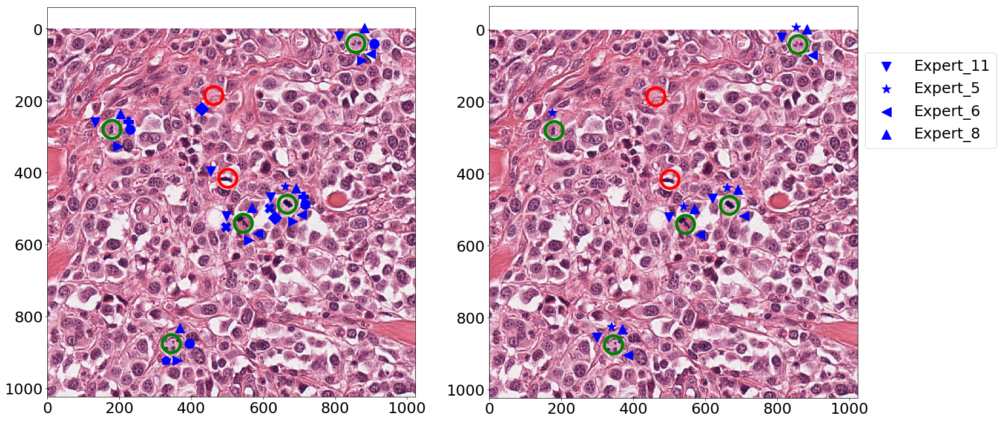

285f74bb6be025a676b6.tiff


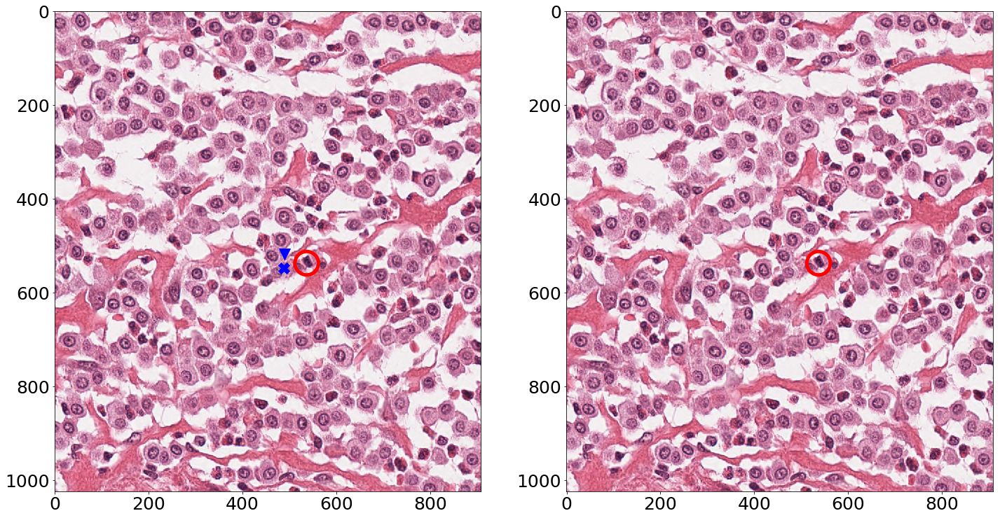

2e611073cff18d503cea.tiff


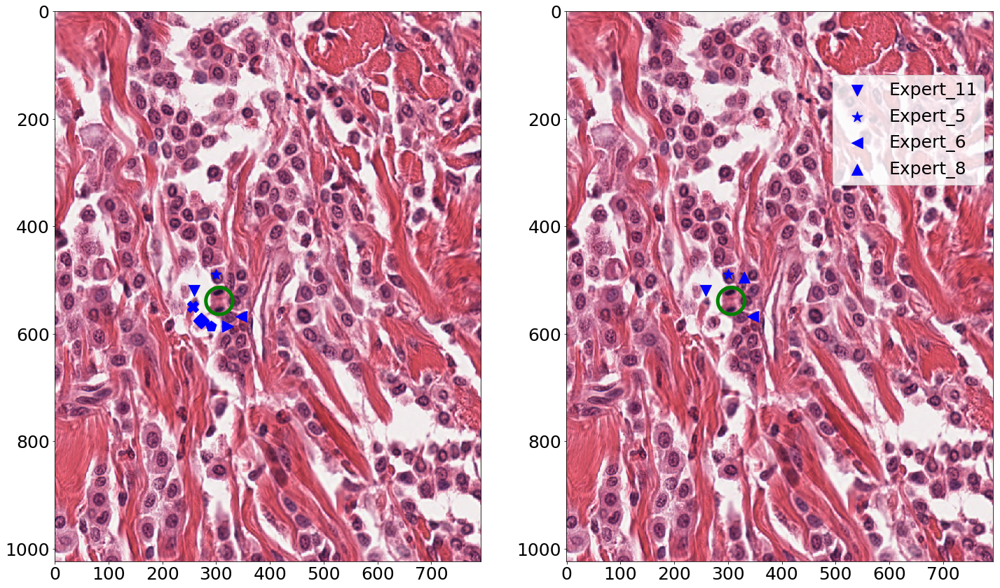

2efb541724b5c017c503.tiff


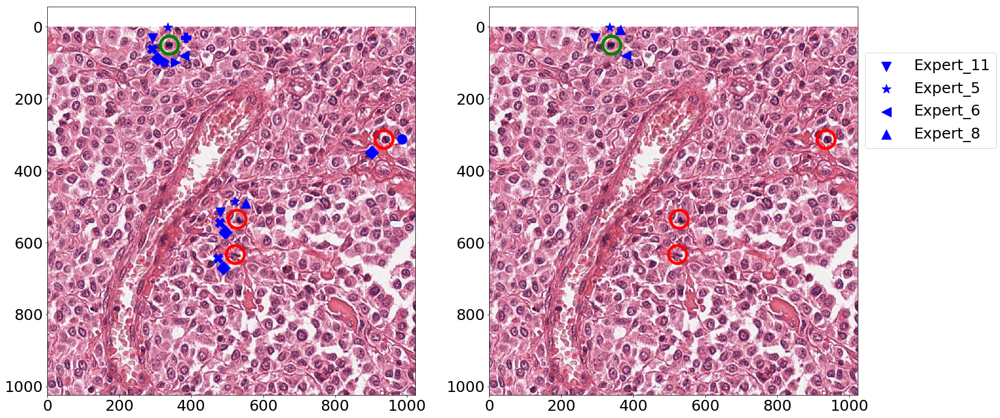

2f17d43b3f9e7dacf24c.tiff


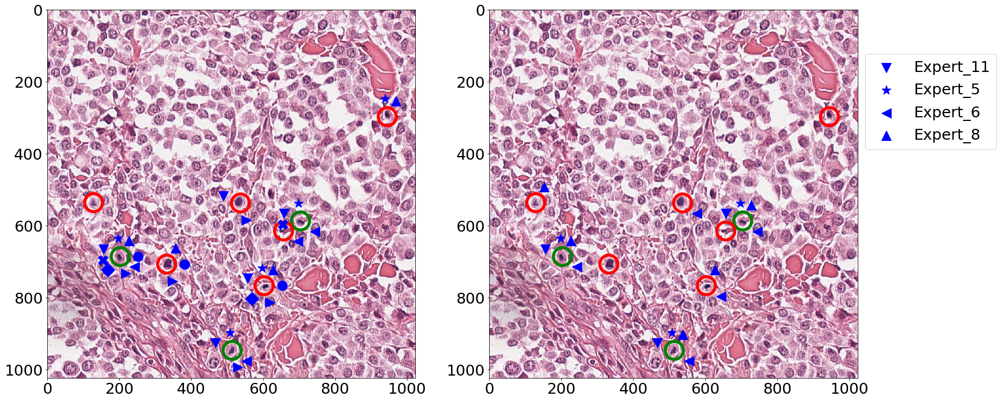

2f2591b840e83a4b4358.tiff


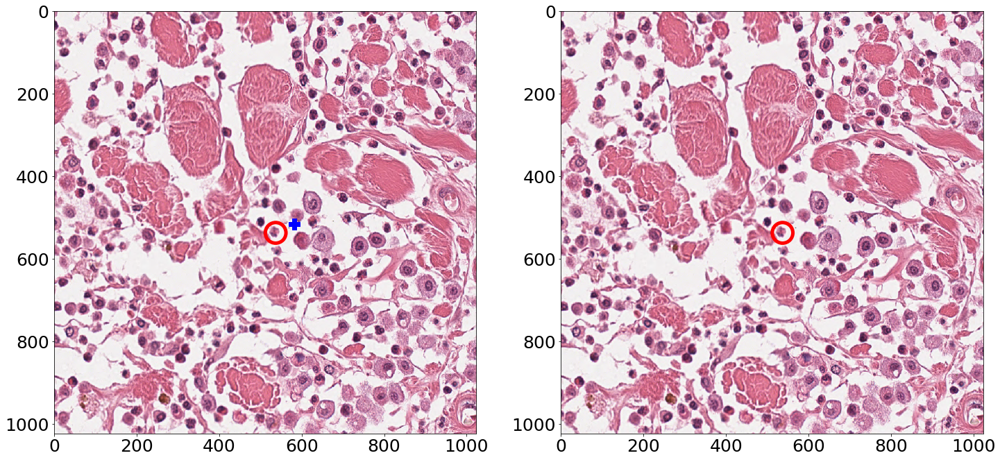

34eb28ce68c1106b2bac.tiff


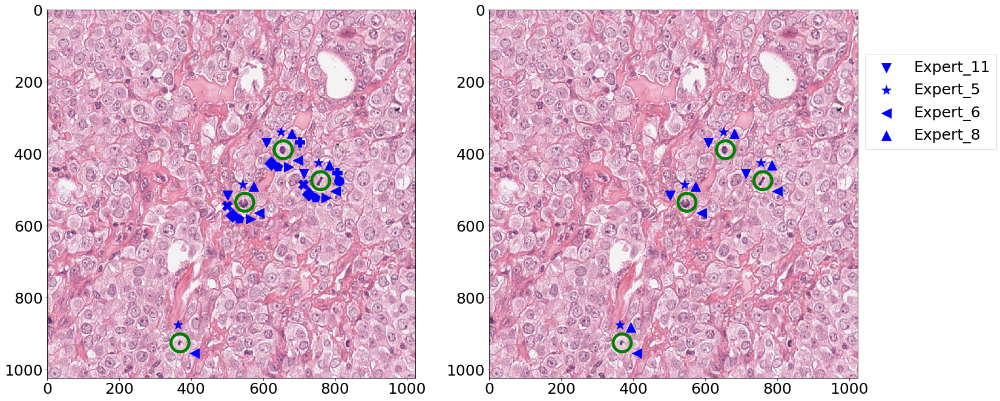

39ecf7f94ed96824405d.tiff


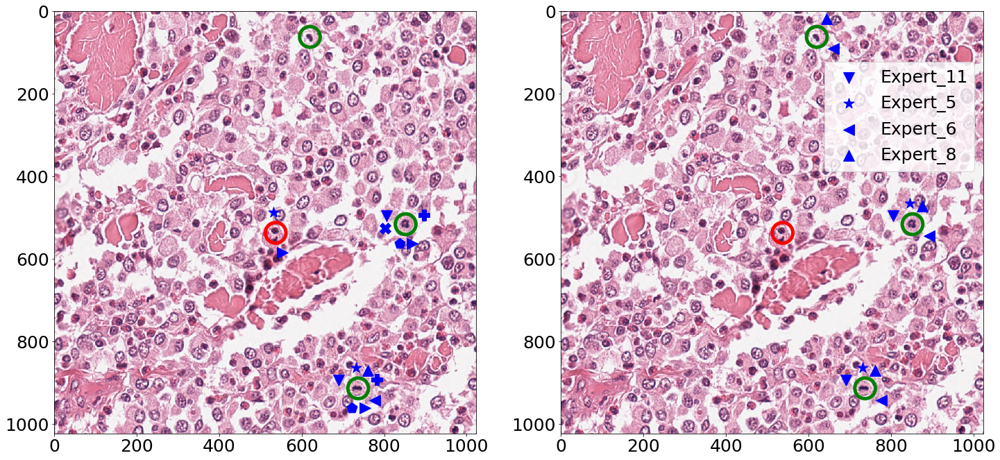

3f2e034c75840cb901e6.tiff


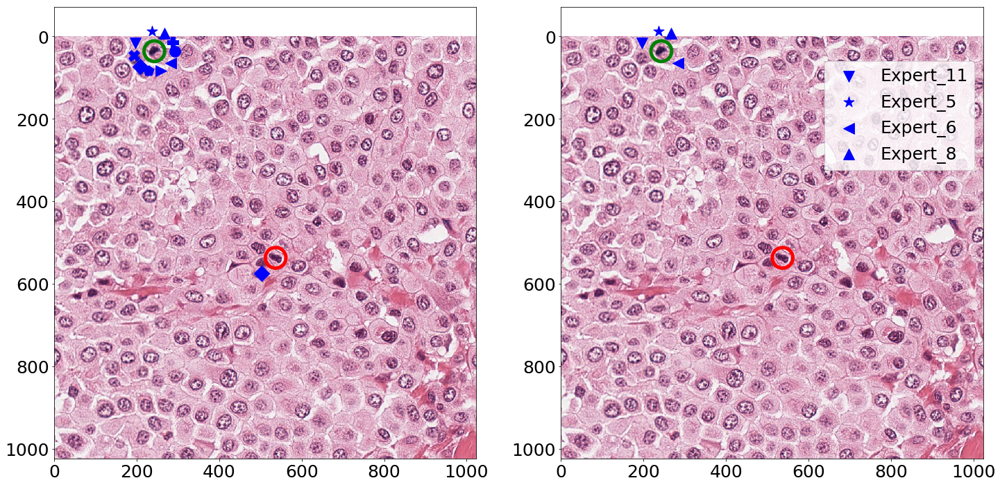

70ed18cd5f806cf396f0.tiff


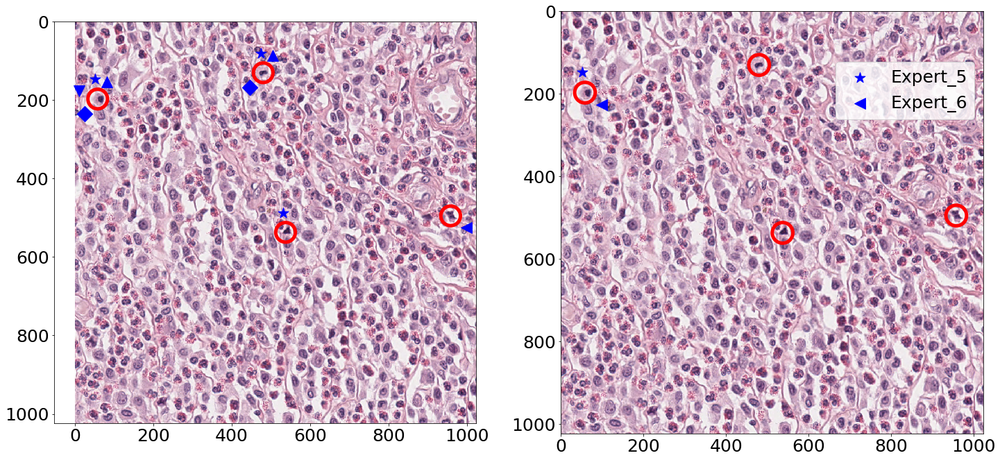

8bebdd1f04140ed89426.tiff


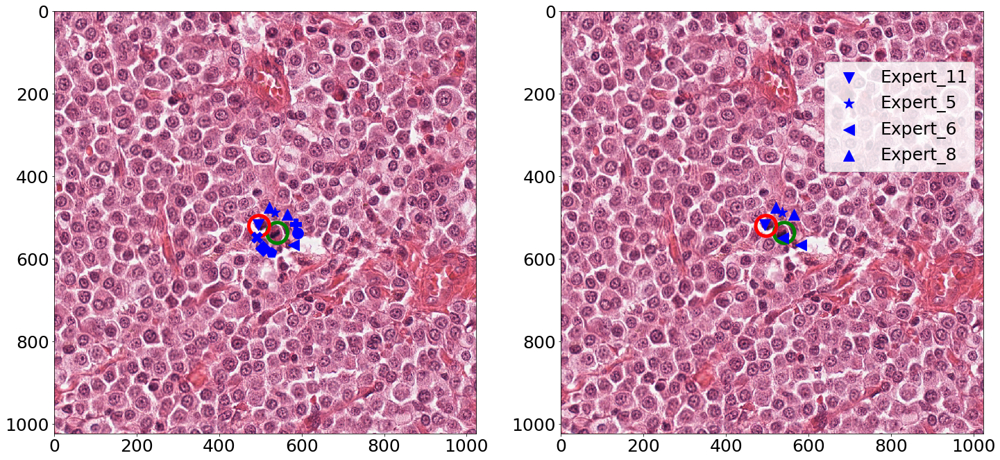

91a8e57ea1f9cb0aeb63.tiff


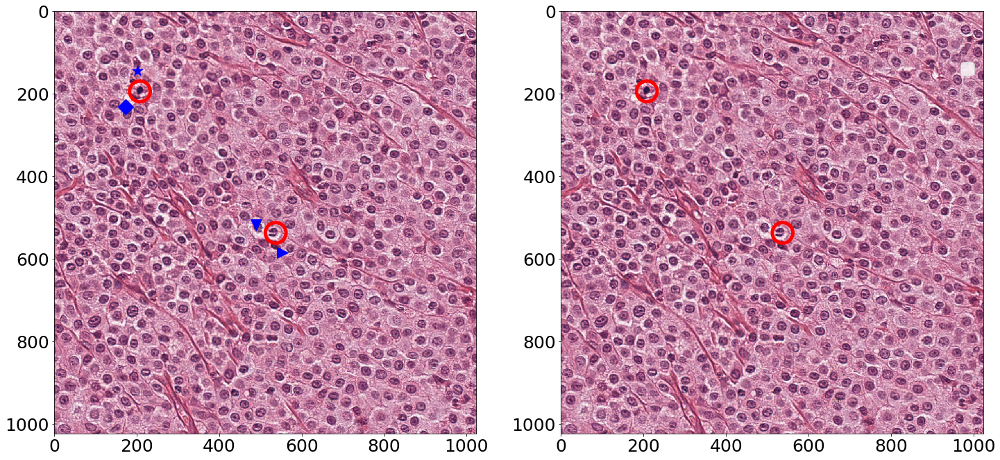

9374efe6ac06388cc877.tiff


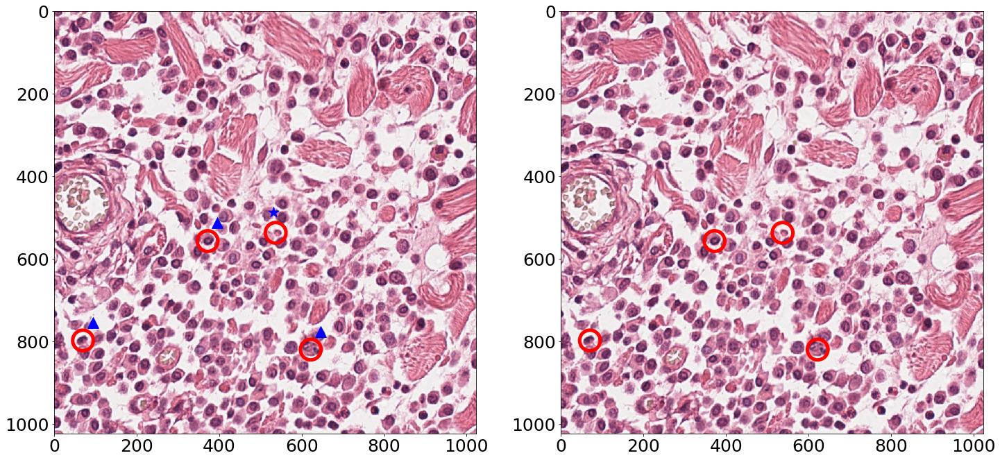

ac1168b2c893d2acad38.tiff


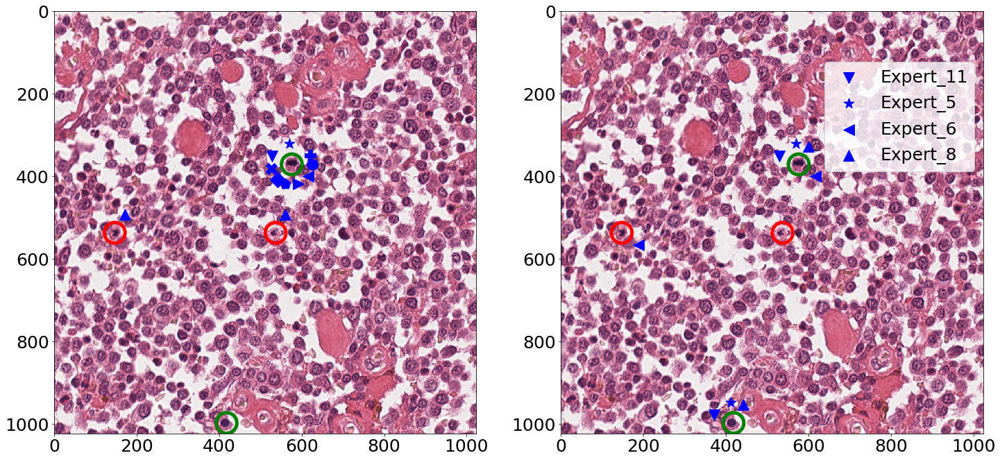

c3eb4b8382b470dd63a9.tiff


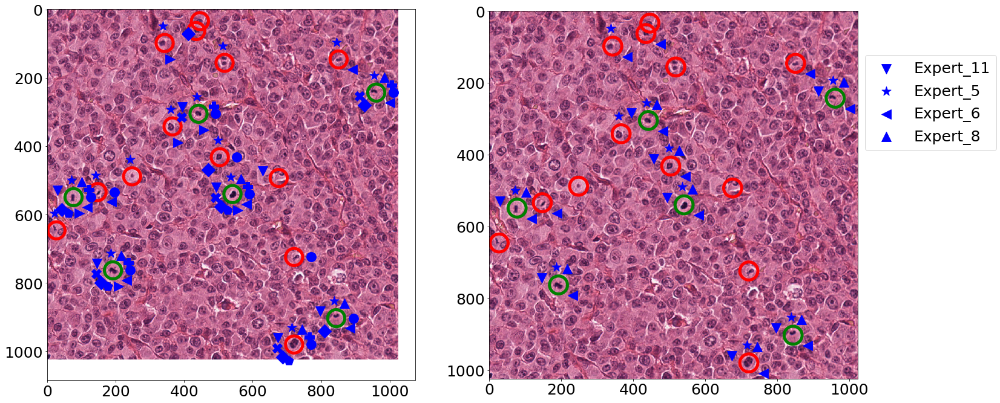

ce949341ba99845813ac.tiff


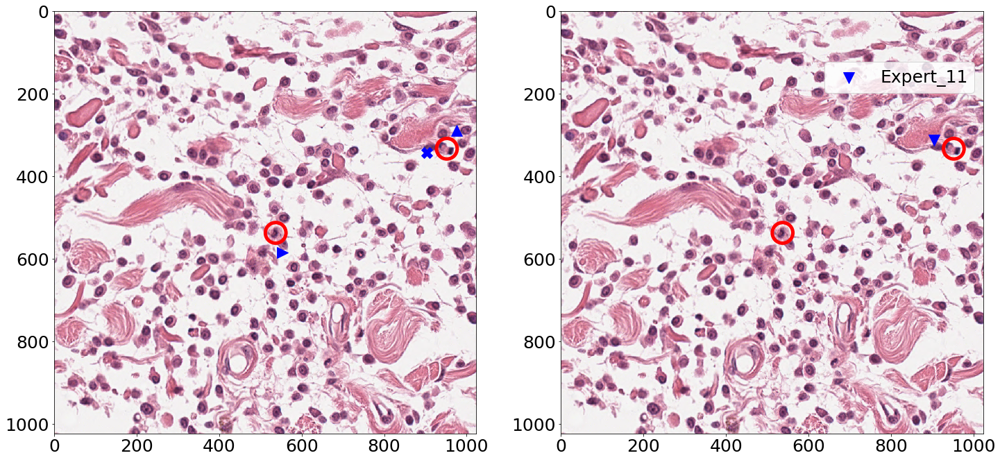

dd6dd0d54b81ebc59c77.tiff


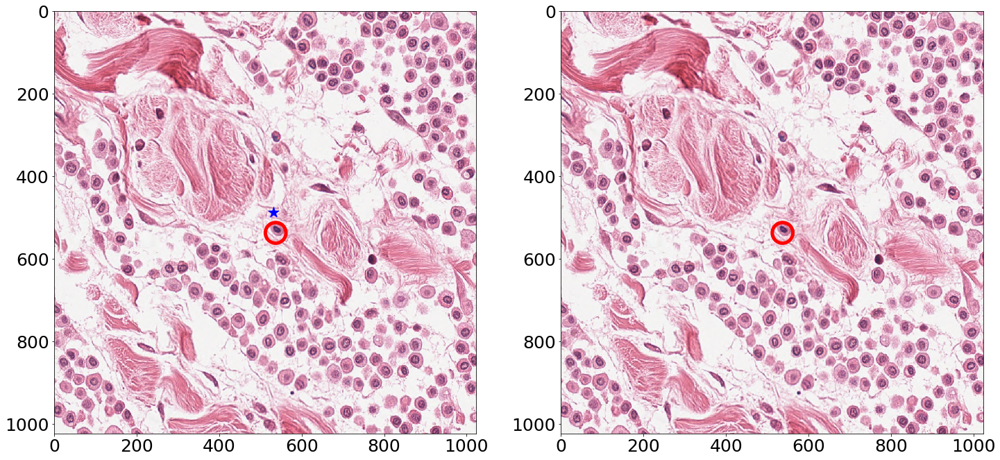

fff27b79894fe0157b08.tiff


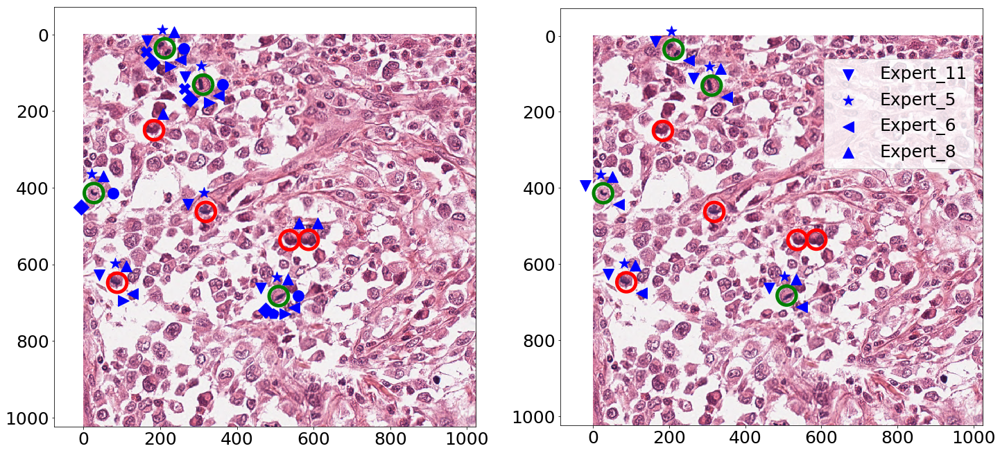

In [35]:
for file_name in path_dict:
    if ".tiff" not in file_name:
        continue

    print(file_name)
    center_anno, center_count, patch_borders = statistics.get_most_active_region(file_name)
    annotations = statistics.get_annotations(file_name)
    
    x_min, y_min, x_max, y_max = patch_borders
    
    im = np.array(PILImage.open(str(path_dict[file_name])), dtype=np.uint8)[y_min:y_max, x_min:x_max]

    fig = plt.figure(figsize=(24, 24))

    ax_anno = fig.add_subplot(1,2, 1)
    ax_alg = fig.add_subplot(1,2, 2)

    ax_anno.imshow(im)
    ax_alg.imshow(im)

    # draw ground truth 
    drawn_centers = []

    gt_annotations = annotations[annotations['ProjectType'] == ProjectType.GroundTruth]
    for name, vector, label, project_type in gt_annotations.values.tolist():
        if vector[0] < x_min or vector[1] < y_min or  vector[2] > x_max or vector[3] > y_max:
            continue           

        if project_type == ProjectType.GroundTruth:
            #circle = patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none')

            ax_anno.add_patch(patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none'))   
            ax_alg.add_patch(patches.Circle((vector[0] - x_min + 25, vector[1] - y_min + 25), 25, linewidth=5, edgecolor='g', facecolor='none'))   

            center = (vector[0] + (vector[2] - vector[0]) / 2, vector[1] + (vector[3] - vector[1]) / 2)
            drawn_centers.append(center)



    participants_annos = annotations[annotations['ProjectType'] != ProjectType.GroundTruth]
    for name, vector, label, project_type in participants_annos.values.tolist():

        if vector[0] < x_min or vector[1] < y_min or  vector[2] > x_max or vector[3] > y_max:
            continue
            
        center = (vector[0] + (vector[2] - vector[0]) / 2, vector[1] + (vector[3] - vector[1]) / 2)    

        if len(drawn_centers) > 0:
            tree = KDTree(drawn_centers)         
            index_per_point = tree.query_radius([center], r=25)[0]
        else:
            index_per_point = []

        circle_center = (vector[0] - x_min + 25, vector[1] - y_min + 25)
        if len(index_per_point) == 0:
            ax_anno.add_patch(patches.Circle(circle_center, 25, linewidth=5, edgecolor='r', facecolor='none'))  
            ax_alg.add_patch(patches.Circle(circle_center, 25, linewidth=5, edgecolor='r', facecolor='none'))  

            drawn_centers.append(center)
        else:
            circle_center = drawn_centers[index_per_point[0]]
            circle_center = (circle_center[0] - x_min, circle_center[1] - y_min)


        #  draw symbol around circle
        x = int(circle_center[0] + 50 * offset[name][0])
        y = int(circle_center[1] + 50 * offset[name][1])

        if project_type == ProjectType.Annotation:
            ax_anno.scatter(x= x, y= y, marker=symbols[name], label=name, s=250, c='b', zorder=100)
        else:
            ax_alg.scatter(x= x, y= y, marker=symbols[name], label=name, s=250, c='b', zorder=100)


    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = OrderedDict(zip(labels, handles))
    ax_alg.legend(by_label.values(), by_label.keys(), frameon=True, bbox_to_anchor=(1., 0.9))

    plt.show()